## Finding text using edge detection



The purpose of this assignment is to use computer vision to extract specific features from images. In particular, we're going to see if we can find text. We are not interested in finding whole words right now; we'll look at how to find whole words in a coming class. For now, we only want to find language-like objects, such as letters and punctuation.



__Download and save the image at the link below:__
https://upload.wikimedia.org/wikipedia/commons/f/f4/%22We_Hold_These_Truths%22_at_Jefferson_Memorial_IMG_4729.JPG



__Using the skills you have learned up to now, do the following tasks:__



Draw a green rectangular box to show a region of interest (ROI) around the main body of text in the middle of the image. Save this as image_with_ROI.jpg.
Crop the original image to create a new image containing only the ROI in the rectangle. Save this as image_cropped.jpg.
Using this cropped image, use Canny edge detection to 'find' every letter in the image
Draw a green contour around each letter in the cropped image. Save this as image_letters.jpg


__TIPS__

Remember all of the skills you've learned so far and think about how they might be useful
This means: colour models; cropping; masking; simple and adaptive thresholds; binerization; mean, median, and Gaussian blur.
Experiment with different approaches until you are able to find as many of the letters and punctuation as possible with the least amount of noise. You might not be able to remove all artifacts - that's okay!


__Bonus challenges__

If you want to push yourself, try to write a script which runs from the command line and which takes any similar input (an image containing text) and produce a similar output (a new image with contours drawn around every letter).


__General instructions__

For this exercise, you can upload either a standalone script OR a Jupyter Notebook
Save your script as edge_detection.py OR edge_detection.ipynb
If you have external dependencies, you must include a requirements.txt
You can either upload the script here or push to GitHub and include a link - or both!
Your code should be clearly documented in a way that allows others to easily follow along
Similarly, remember to use descriptive variable names! A name like cropped is more readable than crp.
The filenames of the saved images should clearly relate to the original image


__Purpose__

This assignment is designed to test that you have a understanding of:

how to use a variety of image processing steps;
how to perform edge detection;
how to combine these skills in order to find specific features in an image

In [2]:
import os
import sys
sys.path.append(os.path.join("..")) # don't forget ".."!!! (otherwise utils don't work)
import cv2
import numpy as np
from utils.imutils import jimshow
from utils.imutils import jimshow_channel
import matplotlib.pyplot as plt



In [3]:
image = cv2.imread(os.path.join("..", "data", "we_hold_these_truths.JPG"))

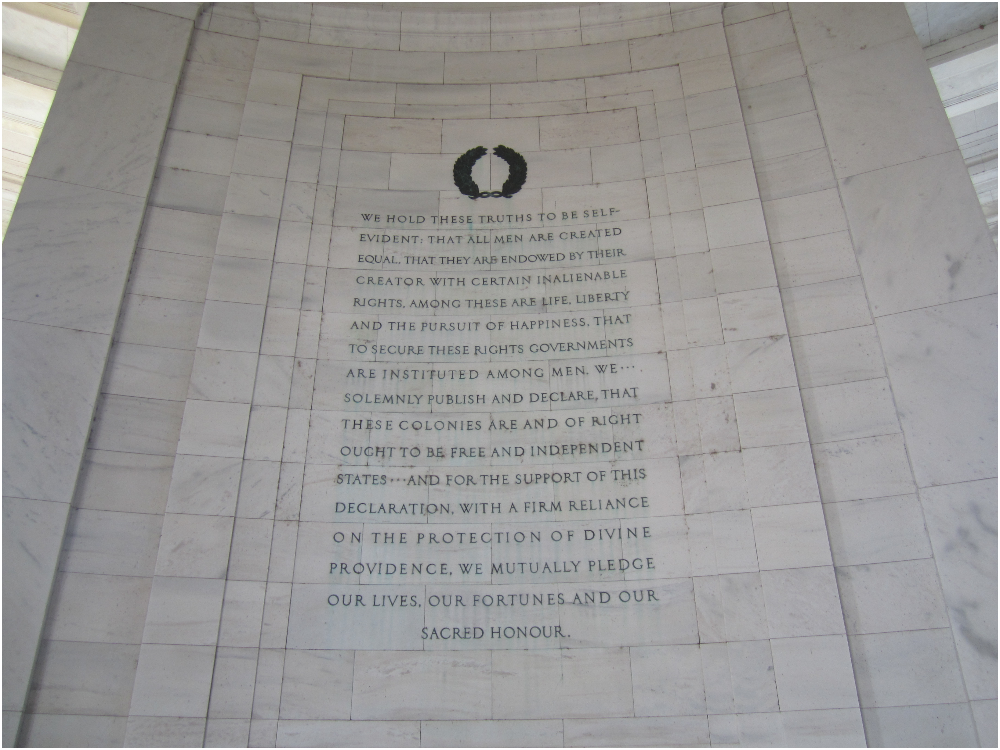

In [36]:
jimshow(image)

__Strategy__
- greyscale
- mask the surrounding
- blurr letters

First, solve the problem, then make it more generalizable

In [4]:
grey_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
#jimshow_channel(grey_image)

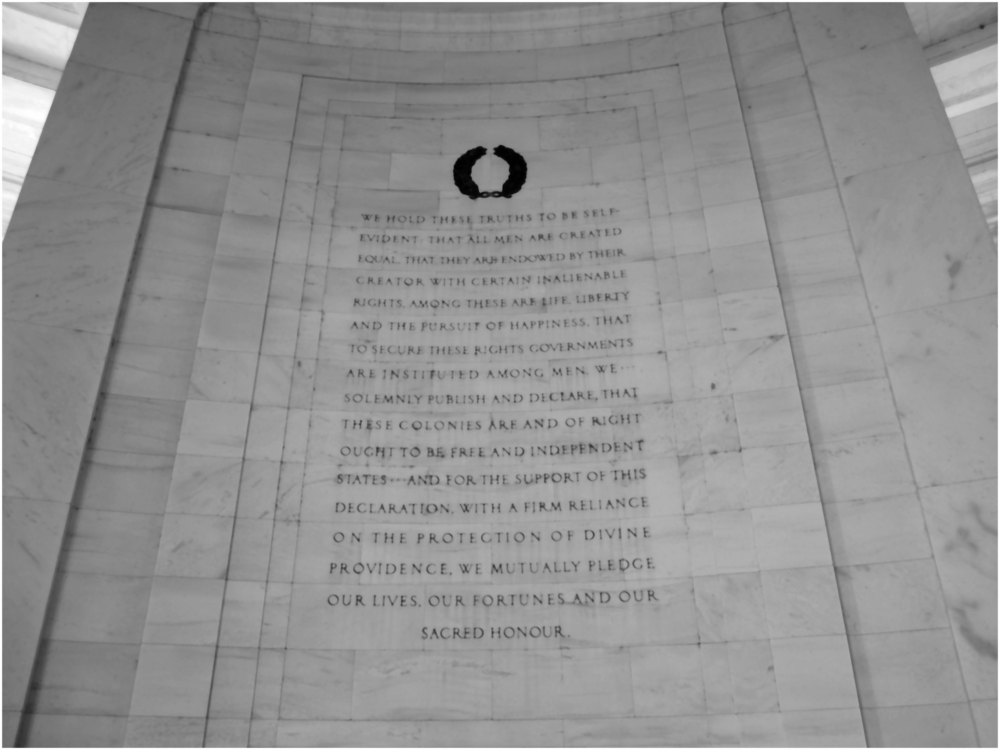

In [46]:
# blurring
blurred = cv2.medianBlur(grey_image, 11, 0)
jimshow_channel(blurred)

In [50]:
grey_image.shape

#jimshow_channel(grey_image[850:3000,1200:3000])

grey = grey_image[850:3000,1250:3000]

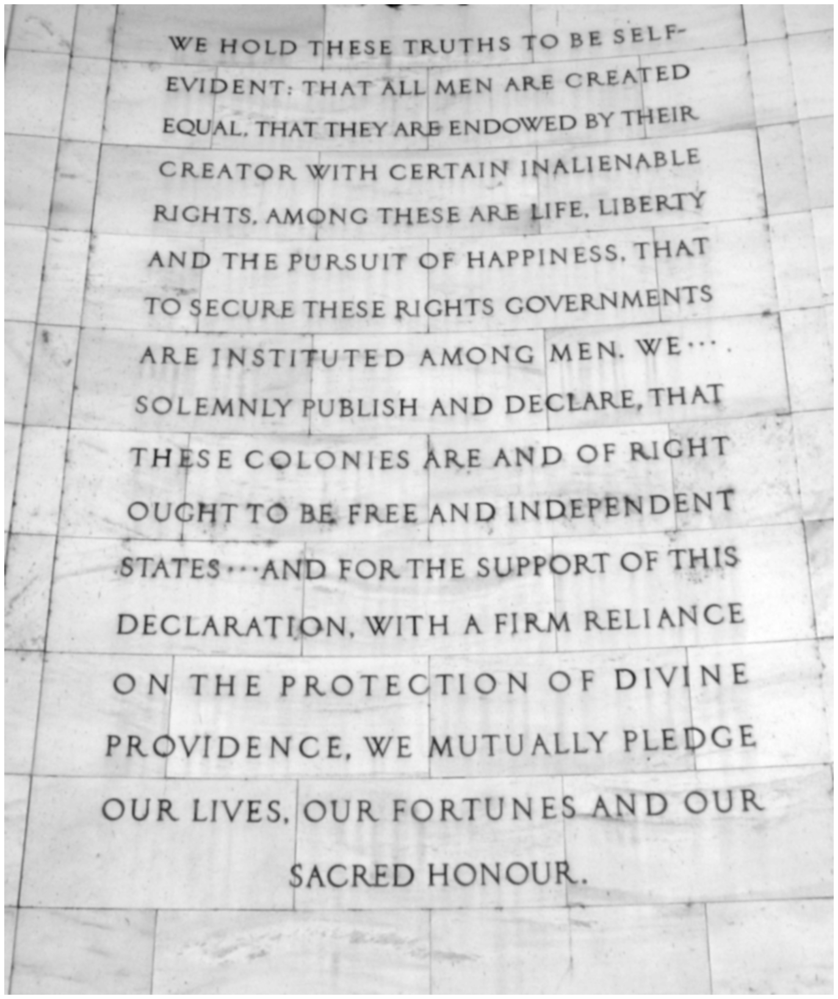

In [24]:
blurred = cv2.GaussianBlur(image2, (11,11), 0)
jimshow_channel(blurred)

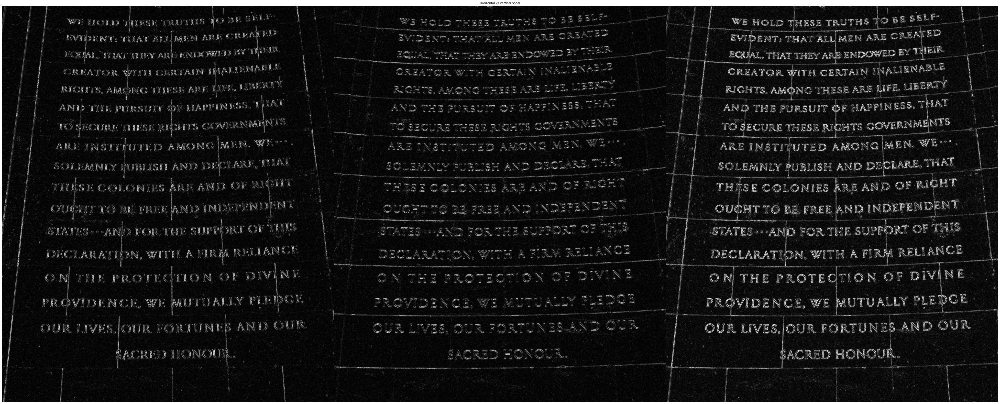

In [29]:
#sobel
# Sobel operatator
sobelX = cv2.Sobel(grey, cv2.CV_64F, 1, 0)# vertical gradients
sobelY = cv2.Sobel(grey, cv2.CV_64F, 0, 1)# horizontal gradients
sobelX = np.uint8(np.absolute(sobelX))
sobelY = np.uint8(np.absolute(sobelY))
blurred = np.hstack([sobelX, sobelY])

sobelCombined = cv2.bitwise_or(sobelX, sobelY)
blurred = np.hstack([sobelX, sobelY,sobelCombined])

jimshow_channel(blurred, "Horizontal vs vertical Sobel")

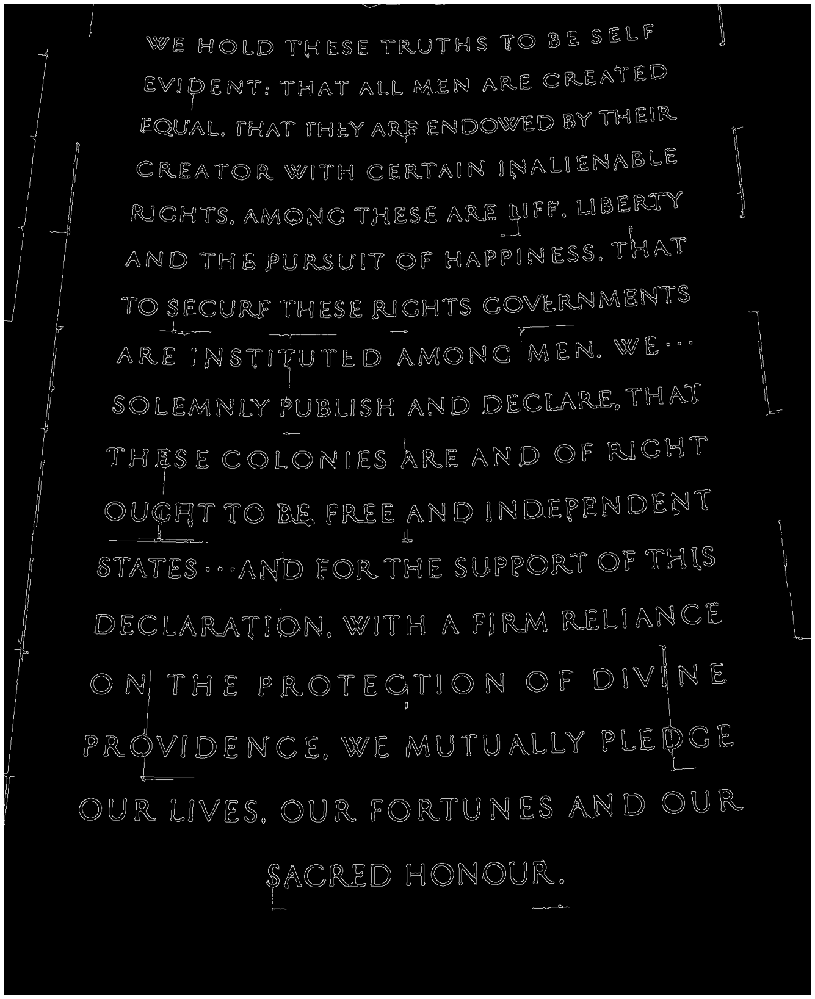

In [54]:
blurred = cv2.medianBlur(grey,  7, 0)
canny = cv2.Canny(blurred, 30, 150)
jimshow_channel(canny)

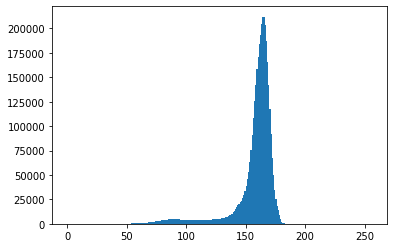

In [55]:
plt.hist(grey.flatten(),256,[0,256])
plt.show()

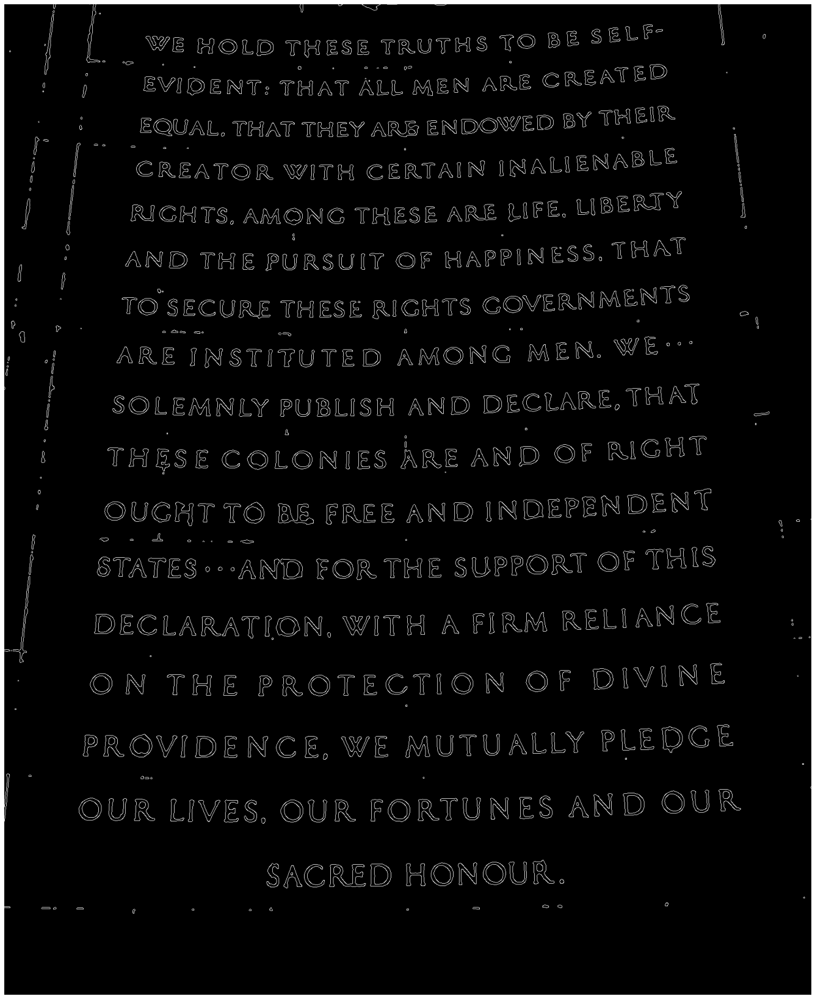

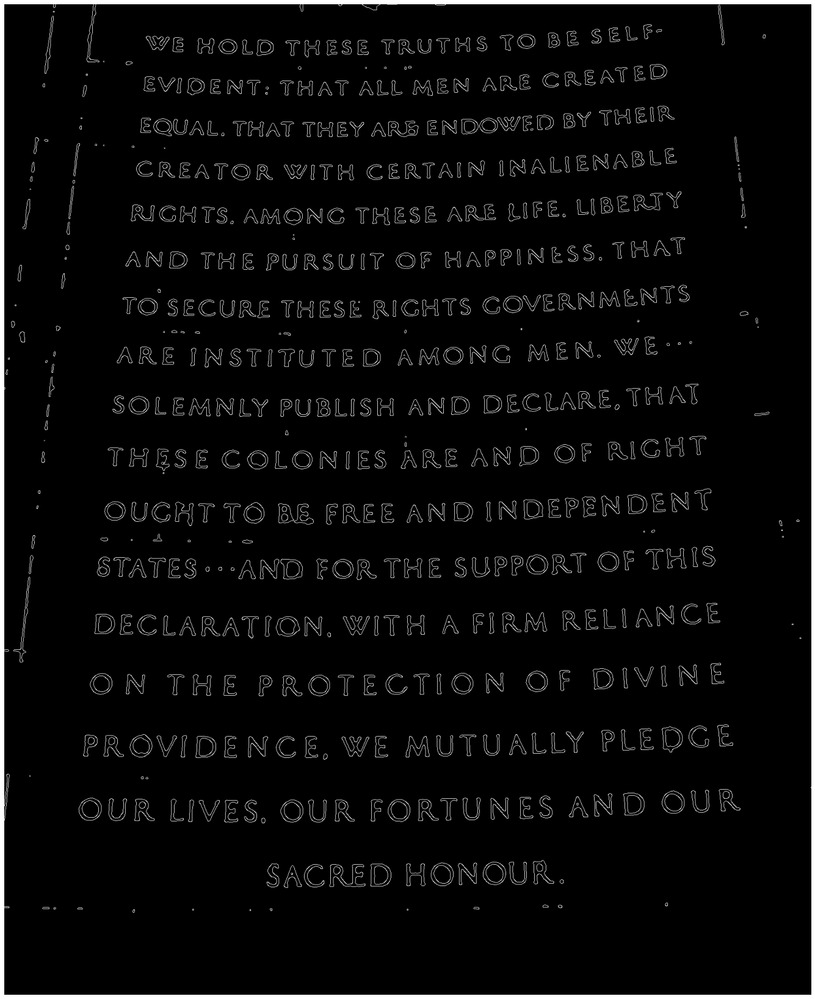

In [74]:

blurred_mini = cv2.medianBlur(grey,  5, 0)

(T, thres) = cv2.threshold(blurred_mini , 125, 255, cv2.THRESH_BINARY)
blurred = cv2.medianBlur(thres,  5, 0)
canny = cv2.Canny(blurred, 30, 150)
jimshow_channel(canny)
